In [27]:
#!pip install torch 
#!pip install torchsummary
#!pip install torchvision
#!pip install --user torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu118

import torch
import os
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torchsummary import summary
import matplotlib.pyplot as plt
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, random_split
from cnn_trainer import CNN
import numpy as np
import seaborn as sns
from scipy.stats import gaussian_kde
from sklearn.metrics import accuracy_score, f1_score

# model_1_dir = 'CNN_model_1_final_2024_11_27_11_19_34_over-midfitted.pth'
# model_2_dir = 'CNN_model_2_final_2024_11_27_11_28_41_over-midfitted.pth'
model_1_dir = 'CNN_model_1_final_2024_11_27_11_50_43.pth'
model_2_dir = 'CNN_model_2_final_2024_11_27_11_38_38.pth'
test_data_1_dir = 'data_for_model_1/test/'
test_data_2_dir = 'data_for_model_2/test/'
train_data_1_dir = 'data_for_model_1/train/'
train_data_2_dir = 'data_for_model_2/train/'

In [28]:
# Load the model
model_1 = CNN(num_classes=2)
weights = torch.load(model_1_dir, map_location=torch.device('cpu'))
model_1.load_state_dict(weights['model_state_dict'])
model_1.eval()

model_2 = CNN(num_classes=2)
weights = torch.load(model_2_dir, map_location=torch.device('cpu'))
model_2.load_state_dict(weights['model_state_dict'])
model_2.eval()


# Convert input picture to tensor
transform = transforms.Compose([
        transforms.Grayscale(num_output_channels=1),  # Convert to grayscale
        transforms.Resize((224, 224)),                  # Resize to desired dimensions
        transforms.ToTensor()   
   ])

# Load data set
dataset_test_1 = datasets.ImageFolder(test_data_1_dir,transform=transform)
dataset_train_1 = datasets.ImageFolder(train_data_1_dir,transform=transform)
dataset_test_2 = datasets.ImageFolder(test_data_2_dir,transform=transform)
dataset_train_2 = datasets.ImageFolder(train_data_2_dir,transform=transform)

batch_size = 1
test_loader_1 = DataLoader(dataset_test_1, batch_size=batch_size, shuffle=True)
train_loader_1 = DataLoader(dataset_train_1, batch_size=batch_size, shuffle=True)
test_loader_2 = DataLoader(dataset_test_2, batch_size=batch_size, shuffle=True)
train_loader_2 = DataLoader(dataset_train_2, batch_size=batch_size, shuffle=True)

# Test the model
correct = 0.0
wrong_predictions = {"pictures": [], "probs": [], "predictions":[],"targets":[]}

C:\Users\hskay\AppData\Local\Temp\ipykernel_21824\2174142130.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  weights = torch.load(model_1_dir, map_location=torch.device(

Accuracy: 77.40%


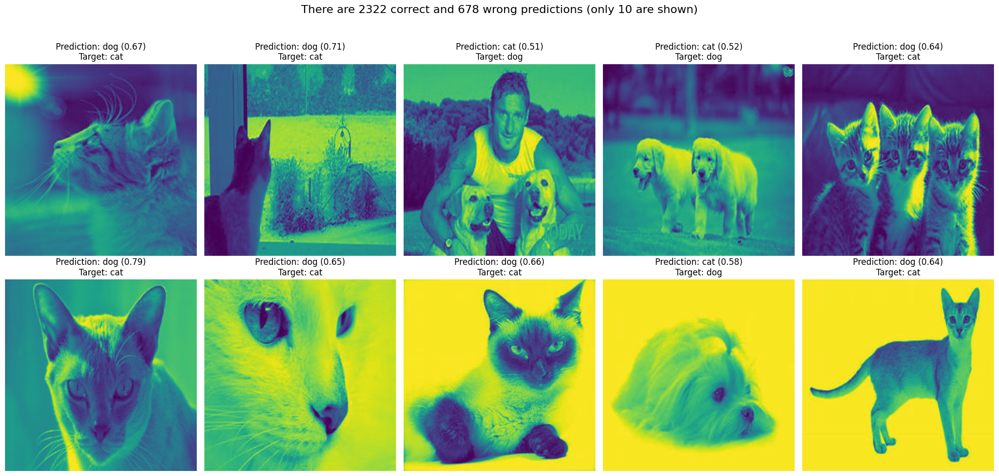

In [29]:
correct = 0.0
wrong_predictions = {"pictures": [], "probs": [], "predictions":[],"targets":[]}
with torch.no_grad():
    for images, targets in train_loader_1:
        outputs = model_1(images)
        _, predicted = torch.max(outputs, 1)

        if predicted.item() != targets.item():
            # Convert from (C, H, W) to (H, W, C)
            image = images[0].permute(1, 2, 0).numpy()  
            wrong_predictions["pictures"].append(image)

            # Get probability of the predicted class
            prob = nn.functional.softmax(outputs, dim=1)[0][predicted.item()]
            wrong_predictions["probs"].append(prob)

            # Get the predicted class
            wrong_predictions["predictions"].append(dataset_train_1.classes[predicted.item()])
            wrong_predictions["targets"].append(dataset_train_1.classes[targets.item()])
            
        correct += (predicted == targets).sum().item()

print(f"Accuracy: {100 * correct / len(dataset_train_1):.2f}%")
# Plot wrong predictions
fig, axes = plt.subplots(2, 5, figsize=(20, 10))  # Adjust grid size (2 rows, 5 columns for 10 images)
fig.suptitle(f"There are {int(correct)} correct and {int(len(dataset_train_1)-correct)} wrong predictions (only 10 are shown)", fontsize=16)

with torch.no_grad():
    for idx, ax in enumerate(axes.flatten()[:min(10, len(wrong_predictions["pictures"]))]):
        ax.imshow(wrong_predictions["pictures"][idx])
        ax.set_title(f"Prediction: {wrong_predictions['predictions'][idx]} ({wrong_predictions['probs'][idx]:.2f})\nTarget: {wrong_predictions['targets'][idx]}")
        ax.axis('off')

# Remove extra subplots if fewer than 10 images are available
for ax in axes.flatten()[len(wrong_predictions["pictures"]):]:
    ax.axis('off')

plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust layout to fit titles
plt.show()

Accuracy: 77.50%


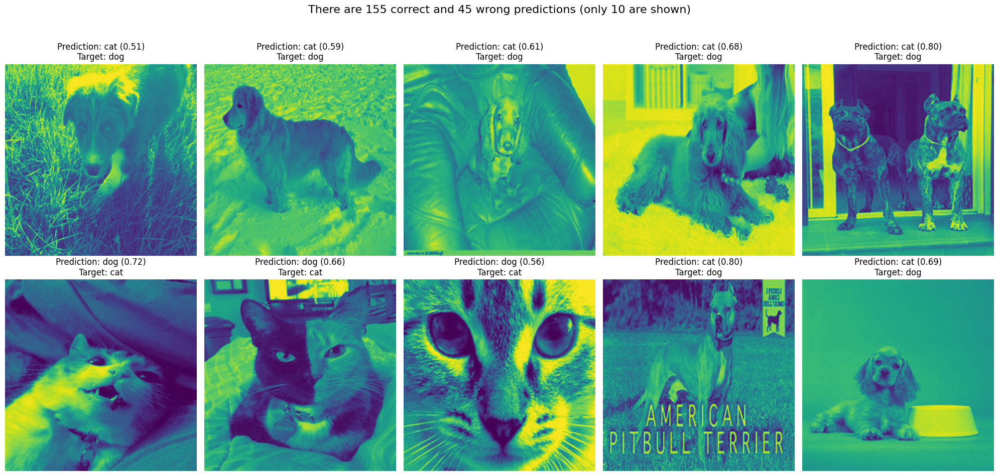

In [30]:
correct = 0.0
wrong_predictions = {"pictures": [], "probs": [], "predictions":[],"targets":[]}
with torch.no_grad():
    for images, targets in test_loader_1:
        outputs = model_1(images)
        _, predicted = torch.max(outputs, 1)

        if predicted.item() != targets.item():
            # Convert from (C, H, W) to (H, W, C)
            image = images[0].permute(1, 2, 0).numpy()  
            wrong_predictions["pictures"].append(image)

            # Get probability of the predicted class
            prob = nn.functional.softmax(outputs, dim=1)[0][predicted.item()]
            wrong_predictions["probs"].append(prob)

            # Get the predicted class
            wrong_predictions["predictions"].append(dataset_test_1.classes[predicted.item()])
            wrong_predictions["targets"].append(dataset_test_1.classes[targets.item()])
            
        correct += (predicted == targets).sum().item()

print(f"Accuracy: {100 * correct / len(dataset_test_1):.2f}%")
# Plot wrong predictions
fig, axes = plt.subplots(2, 5, figsize=(20, 10))  # Adjust grid size (2 rows, 5 columns for 10 images)
fig.suptitle(f"There are {int(correct)} correct and {int(len(dataset_test_1)-correct)} wrong predictions (only 10 are shown)", fontsize=16)

with torch.no_grad():
    for idx, ax in enumerate(axes.flatten()[:min(10, len(wrong_predictions["pictures"]))]):
        ax.imshow(wrong_predictions["pictures"][idx])
        ax.set_title(f"Prediction: {wrong_predictions['predictions'][idx]} ({wrong_predictions['probs'][idx]:.2f})\nTarget: {wrong_predictions['targets'][idx]}")
        ax.axis('off')

# Remove extra subplots if fewer than 10 images are available
for ax in axes.flatten()[len(wrong_predictions["pictures"]):]:
    ax.axis('off')

plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust layout to fit titles
plt.show()

Accuracy: 85.30%


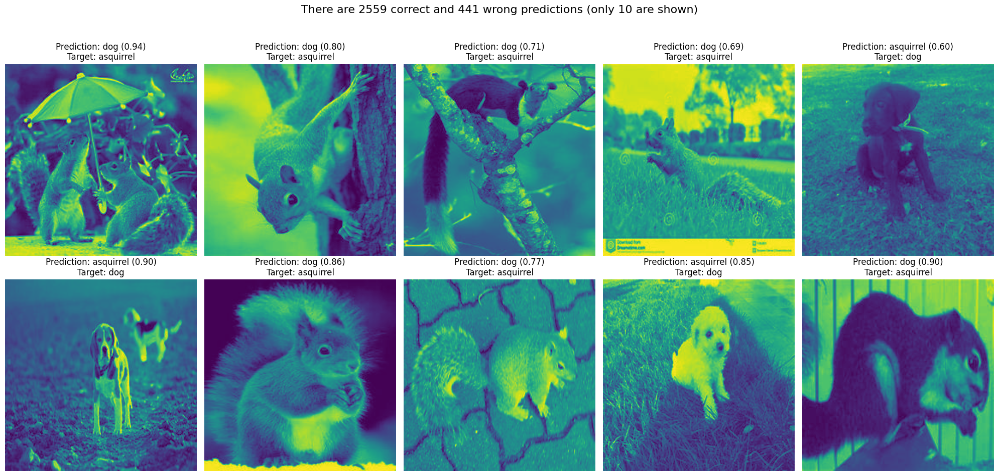

In [31]:
correct = 0.0
wrong_predictions = {"pictures": [], "probs": [], "predictions":[],"targets":[]}
with torch.no_grad():
    for images, targets in train_loader_2:
        outputs = model_2(images)
        _, predicted = torch.max(outputs, 1)

        if predicted.item() != targets.item():
            # Convert from (C, H, W) to (H, W, C)
            image = images[0].permute(1, 2, 0).numpy()  
            wrong_predictions["pictures"].append(image)

            # Get probability of the predicted class
            prob = nn.functional.softmax(outputs, dim=1)[0][predicted.item()]
            wrong_predictions["probs"].append(prob)

            # Get the predicted class
            wrong_predictions["predictions"].append(dataset_train_2.classes[predicted.item()])
            wrong_predictions["targets"].append(dataset_train_2.classes[targets.item()])
            
        correct += (predicted == targets).sum().item()

print(f"Accuracy: {100 * correct / len(dataset_train_2):.2f}%")
# Plot wrong predictions
fig, axes = plt.subplots(2, 5, figsize=(20, 10))  # Adjust grid size (2 rows, 5 columns for 10 images)
fig.suptitle(f"There are {int(correct)} correct and {int(len(dataset_train_2)-correct)} wrong predictions (only 10 are shown)", fontsize=16)

with torch.no_grad():
    for idx, ax in enumerate(axes.flatten()[:min(10, len(wrong_predictions["pictures"]))]):
        ax.imshow(wrong_predictions["pictures"][idx])
        ax.set_title(f"Prediction: {wrong_predictions['predictions'][idx]} ({wrong_predictions['probs'][idx]:.2f})\nTarget: {wrong_predictions['targets'][idx]}")
        ax.axis('off')

# Remove extra subplots if fewer than 10 images are available
for ax in axes.flatten()[len(wrong_predictions["pictures"]):]:
    ax.axis('off')

plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust layout to fit titles
plt.show()

Accuracy: 81.00%


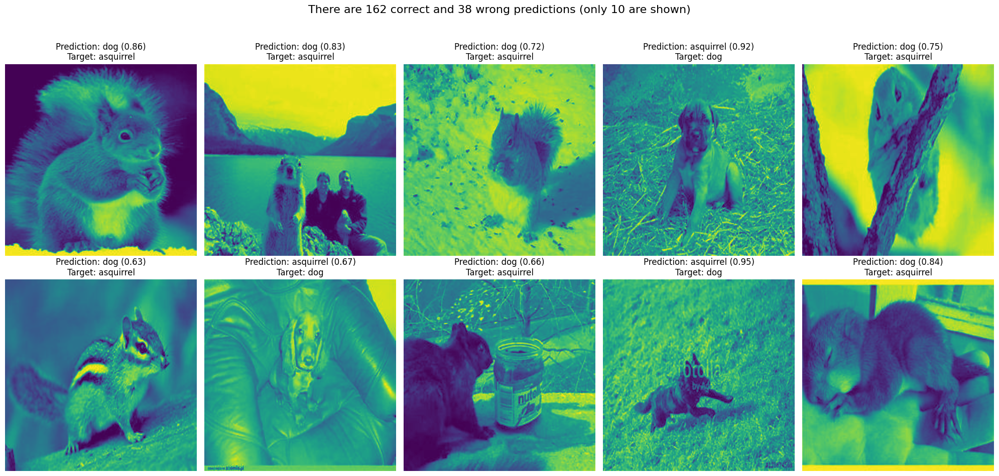

In [32]:
correct = 0.0
wrong_predictions = {"pictures": [], "probs": [], "predictions":[],"targets":[]}
with torch.no_grad():
    for images, targets in test_loader_2:
        outputs = model_2(images)
        _, predicted = torch.max(outputs, 1)

        if predicted.item() != targets.item():
            # Convert from (C, H, W) to (H, W, C)
            image = images[0].permute(1, 2, 0).numpy()  
            wrong_predictions["pictures"].append(image)

            # Get probability of the predicted class
            prob = nn.functional.softmax(outputs, dim=1)[0][predicted.item()]
            wrong_predictions["probs"].append(prob)

            # Get the predicted class
            wrong_predictions["predictions"].append(dataset_test_2.classes[predicted.item()])
            wrong_predictions["targets"].append(dataset_test_2.classes[targets.item()])
            
        correct += (predicted == targets).sum().item()

print(f"Accuracy: {100 * correct / len(dataset_test_2):.2f}%")
# Plot wrong predictions
fig, axes = plt.subplots(2, 5, figsize=(20, 10))  # Adjust grid size (2 rows, 5 columns for 10 images)
fig.suptitle(f"There are {int(correct)} correct and {int(len(dataset_test_2)-correct)} wrong predictions (only 10 are shown)", fontsize=16)

with torch.no_grad():
    for idx, ax in enumerate(axes.flatten()[:min(10, len(wrong_predictions["pictures"]))]):
        ax.imshow(wrong_predictions["pictures"][idx])
        ax.set_title(f"Prediction: {wrong_predictions['predictions'][idx]} ({wrong_predictions['probs'][idx]:.2f})\nTarget: {wrong_predictions['targets'][idx]}")
        ax.axis('off')

# Remove extra subplots if fewer than 10 images are available
for ax in axes.flatten()[len(wrong_predictions["pictures"]):]:
    ax.axis('off')

plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust layout to fit titles
plt.show()

tensor([0])
tensor([1])
tensor([1])


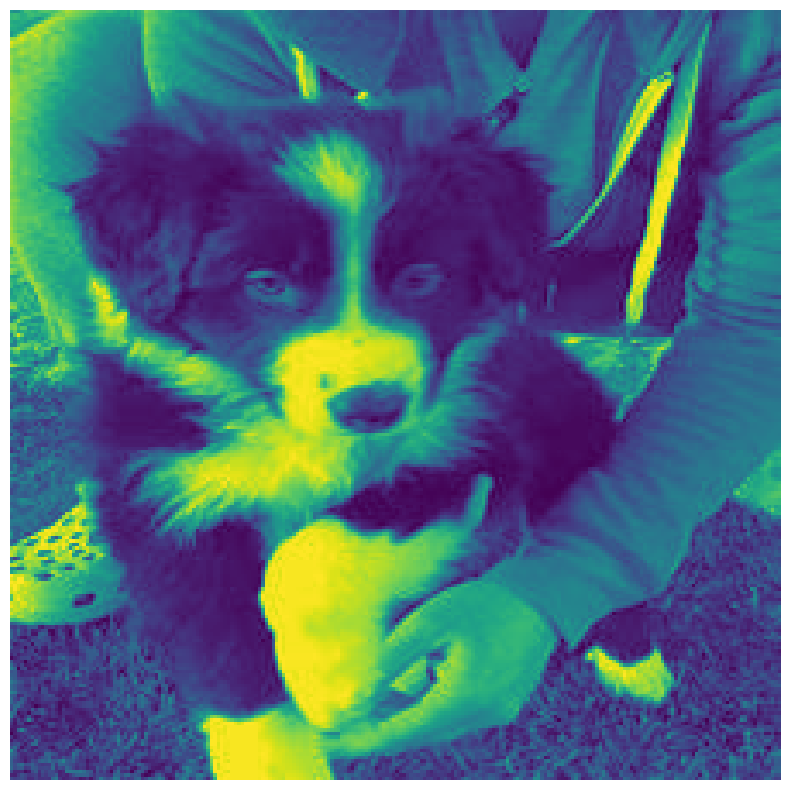

In [48]:
for index,i in enumerate(train_loader_1):
    out = model_1(i[0])
    first_picture = i[0]
    print(i[1])
    if index ==2:
        break
fig = plt.figure(figsize=(20, 10))
plt.imshow(first_picture.reshape(224,224))
plt.axis('off')
plt.show()

In [49]:
def visualize_feature_maps_h(feature_maps, model_name):
    for layer_name, fmap in feature_maps.items():
        print(f"Model: {model_name}, Layer: {layer_name}")
        
        # Handle different fmap shapes (e.g., for Linear layers)
        if len(fmap.shape) == 4:  # Conv layers
            num_features = min(16, fmap.shape[1])
            fig, axes = plt.subplots(1, num_features, figsize=(num_features * 3, 3))
            for idx in range(num_features):
                axes[idx].imshow(fmap[0, idx].detach(), cmap='viridis')
                axes[idx].axis('off')
        elif len(fmap.shape) == 2:  # Linear layers
            num_features = min(16, fmap.shape[1])
            fig, axes = plt.subplots(1, num_features, figsize=(num_features * 3, 3))
            for idx in range(num_features):
                axes[idx].imshow(fmap[0, idx].detach().reshape(-1, 1), cmap='viridis', aspect='auto')
                axes[idx].axis('off')
        else:
            print(f"Skipping layer {layer_name} with shape {fmap.shape}")
            continue

        plt.suptitle(f"Model: {model_name}, Feature Maps from Layer: {layer_name}")
        plt.show()

def visualize_feature_maps_v(feature_maps_1, feature_maps_2, model_name1, model_name2, max_features=64, 
                         linear_viz_type='distribution', plot_linear=True):

    for layer_name, fmap1 in feature_maps_1.items():
        if layer_name not in feature_maps_2:
            print(f"Layer {layer_name} not found in {model_name2}. Skipping.")
            continue
        
        fmap2 = feature_maps_2[layer_name]
        print(f"Visualizing Layer: {layer_name}")
        
        # Ensure tensors are on CPU and detached
        fmap1 = fmap1.detach().cpu()
        fmap2 = fmap2.detach().cpu()
        
        # Handle Convolutional Layers
        if fmap1.dim() == 4 and fmap2.dim() == 4:
            # [Previous convolutional layer visualization code remains the same]
            _, num_channels, _, _ = fmap1.shape
            num_features = min(num_channels, max_features)
            selected_indices = np.linspace(0, num_channels - 1, num_features, dtype=int)
            
            fig, axes = plt.subplots(2, num_features, figsize=(num_features * 3, 6))
            for idx, feature_idx in enumerate(selected_indices):
                # Model 1 Feature Map
                fmap1_np = fmap1[0, feature_idx].numpy()
                axes[0, idx].imshow(fmap1_np, cmap='viridis')
                axes[0, idx].axis('off')
                axes[0, idx].set_title(f"{model_name1} F{feature_idx}")
                
                # Model 2 Feature Map
                fmap2_np = fmap2[0, feature_idx].numpy()
                axes[1, idx].imshow(fmap2_np, cmap='viridis')
                axes[1, idx].axis('off')
                axes[1, idx].set_title(f"{model_name2} F{feature_idx}")
            
            plt.suptitle(f"Convolutional Layer: {layer_name}")
            plt.tight_layout()
            plt.show()
            
        # Handle Linear Layers
        elif fmap1.dim() == 2 and fmap2.dim() == 2 and plot_linear:
            if linear_viz_type == 'distribution':
                visualize_linear_distribution(fmap1, fmap2, layer_name, model_name1, model_name2, max_features)
            elif linear_viz_type == 'heatmap':
                visualize_linear_heatmap(fmap1, fmap2, layer_name, model_name1, model_name2)
            elif linear_viz_type == 'scatter':
                visualize_linear_scatter(fmap1, fmap2, layer_name, model_name1, model_name2, max_features)
            elif linear_viz_type == 'boxplot':
                visualize_linear_boxplot(fmap1, fmap2, layer_name, model_name1, model_name2, max_features)
        else:
            print(f"Skipping layer {layer_name} with shapes {fmap1.shape} and {fmap2.shape}")

def visualize_linear_distribution(fmap1, fmap2, layer_name, model_name1, model_name2, max_features):
    _, num_features = fmap1.shape
    num_features = min(num_features, max_features)
    selected_indices = np.linspace(0, num_features - 1, num_features, dtype=int)
    
    fig, axes = plt.subplots(2, num_features, figsize=(num_features * 3, 6))
    
    global_mins = []
    global_maxs = []
    global_max_density = []
    
    for idx, feature_idx in enumerate(selected_indices):
        feature_data = []
        for fmap in [fmap1, fmap2]:
            data = fmap[0, int(feature_idx)].numpy().flatten()
            feature_data.append(data)
            
        min_val = min(np.min(feature_data[0]), np.min(feature_data[1]))
        max_val = max(np.max(feature_data[0]), np.max(feature_data[1]))
        
        # Calculate KDE for both models if possible
        x_range = np.linspace(min_val, max_val, 200)
        max_density = 0
        
        for data in feature_data:
            if len(np.unique(data)) > 1:  # Check if we have multiple unique values
                try:
                    kde = gaussian_kde(data)
                    max_density = max(max_density, np.max(kde(x_range)))
                except Exception as e:
                    print(f"Warning: Could not compute KDE for feature {feature_idx}: {e}")
                    max_density = max(max_density, 1.0)  # fallback value
            else:
                max_density = max(max_density, 1.0)  # fallback value for single values
        
        global_mins.append(min_val)
        global_maxs.append(max_val)
        global_max_density.append(max_density * 1.1)  # Add 10% padding
    
    # Second pass: plot with aligned axes
    for idx, feature_idx in enumerate(selected_indices):
        min_val = global_mins[idx]
        max_val = global_maxs[idx]
        max_density = global_max_density[idx]
        
        for i, (fmap, name, color, dark_color) in enumerate([
            (fmap1, model_name1, 'blue', 'darkblue'),
            (fmap2, model_name2, 'green', 'darkgreen')
        ]):
            data = fmap[0, int(feature_idx)].numpy().flatten()
            ax = axes[i, idx]
            
            # Plot histogram
            ax.hist(data, bins=20, density=True, alpha=0.5, color=color)
            
            # Add KDE if possible
            if len(np.unique(data)) > 1:
                try:
                    kde = gaussian_kde(data)
                    x_range = np.linspace(min_val, max_val, 200)
                    ax.plot(x_range, kde(x_range), color=dark_color)
                except Exception as e:
                    print(f"Warning: Could not plot KDE for {name} feature {feature_idx}: {e}")
            else:
                # For single values, just show the histogram
                ax.axvline(data[0], color=dark_color, linestyle='--', alpha=0.5)
                
            # Set consistent axes
            ax.set_xlim(min_val, max_val)
            ax.set_ylim(0, max_density)
            
            ax.set_title(f"{name} F{feature_idx}")
            ax.set_xticks([])
    
    plt.suptitle(f"Linear Layer Distribution: {layer_name}")
    plt.tight_layout()
    plt.show()
    
def visualize_linear_heatmap(fmap1, fmap2, layer_name, model_name1, model_name2):
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 8))
    
    sns.heatmap(fmap1.numpy(), ax=ax1, cmap='viridis', center=0)
    ax1.set_title(f"{model_name1} Activations")
    
    sns.heatmap(fmap2.numpy(), ax=ax2, cmap='viridis', center=0)
    ax2.set_title(f"{model_name2} Activations")
    
    plt.suptitle(f"Linear Layer Heatmap: {layer_name}")
    plt.tight_layout()
    plt.show()

def visualize_linear_scatter(fmap1, fmap2, layer_name, model_name1, model_name2, max_features):
    _, num_features = fmap1.shape
    num_features = min(num_features, max_features)
    selected_indices = np.linspace(0, num_features - 1, num_features, dtype=int)
    
    # Calculate number of rows and columns for subplots
    n_cols = min(4, num_features)  # Maximum 4 plots per row
    n_rows = (num_features + n_cols - 1) // n_cols
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 4, n_rows * 4))
    axes = np.array(axes).reshape(-1)  # Flatten axes array for easier indexing
    
    for idx, feature_idx in enumerate(selected_indices):
        if idx < len(axes):
            # Extract feature values from both models
            x_values = fmap1[0, int(feature_idx)].numpy()
            y_values = fmap2[0, int(feature_idx)].numpy()
            
            # Calculate axis limits
            min_val = min(x_values.min(), y_values.min())
            max_val = max(x_values.max(), y_values.max())
            
            # Create scatter plot
            axes[idx].scatter(x_values, y_values, alpha=0.5, s=20)
            axes[idx].set_title(f"Feature {int(feature_idx)}")
            
            # Set equal axes limits
            axes[idx].set_xlim(min_val, max_val)
            axes[idx].set_ylim(min_val, max_val)
            
            # Add diagonal line for reference
            axes[idx].plot([min_val, max_val], [min_val, max_val], 'r--', alpha=0.5)
            
            # Labels
            axes[idx].set_xlabel(model_name1)
            axes[idx].set_ylabel(model_name2)
            
            # Equal aspect ratio
            axes[idx].set_aspect('equal')
    
    # Hide empty subplots if any
    for idx in range(len(selected_indices), len(axes)):
        axes[idx].axis('off')
    
    plt.suptitle(f"Linear Layer Feature Comparison: {layer_name}")
    plt.tight_layout()
    plt.show()

def visualize_linear_boxplot(fmap1, fmap2, layer_name, model_name1, model_name2, max_features):
    _, num_features = fmap1.shape
    num_features = min(num_features, max_features)
    selected_indices = np.linspace(0, num_features - 1, num_features, dtype=int)
    
    # Create figure
    plt.figure(figsize=(max(8, num_features * 1.5), 6))
    
    # Prepare data and labels
    all_data = []
    labels = []
    
    # Process data feature by feature
    for idx, feature_idx in enumerate(selected_indices):
        feature_idx = int(feature_idx)
        # Get feature data from both models
        data1 = fmap1[0, feature_idx].numpy().flatten()
        data2 = fmap2[0, feature_idx].numpy().flatten()
        
        # Add data and labels
        all_data.append(data1)
        all_data.append(data2)
        labels.append(f"{model_name1}\nF{feature_idx}")
        labels.append(f"{model_name2}\nF{feature_idx}")
    
    # Create box plot
    box_plot = plt.boxplot(all_data, 
                          labels=labels,
                          patch_artist=True)
    
    # Customize colors
    colors = ['lightblue', 'lightgreen'] * int(num_features)
    for patch, color in zip(box_plot['boxes'], colors):
        patch.set_facecolor(color)
    
    # Customize plot
    plt.xticks(rotation=45, ha='right')
    plt.title(f"Linear Layer Distributions: {layer_name}")
    
    # Add a legend
    legend_elements = [plt.Rectangle((0,0),1,1, facecolor='lightblue', label=model_name1),
                      plt.Rectangle((0,0),1,1, facecolor='lightgreen', label=model_name2)]
    plt.legend(handles=legend_elements, loc='upper right')
    
    # Adjust layout
    plt.tight_layout()
    plt.show()

In [50]:
feature_maps_1 = {}
feature_maps_2 = {}

def hook_fn(name, model_index):
    def hook(module, input, output):
        if model_index == 1:
            feature_maps_1[name] = output
        elif model_index == 2:
            feature_maps_2[name] = output
    return hook

# Register hooks
hooks_1 = []
for name, layer in model_1.named_modules():
    hooks_1.append(layer.register_forward_hook(hook_fn(name, 1)))

hooks_2 = []
for name, layer in model_2.named_modules():
    hooks_2.append(layer.register_forward_hook(hook_fn(name, 2)))

# Pass the input through both models
model_1(first_picture)
model_2(first_picture)

tensor([[-0.8387,  1.0132]], grad_fn=<AddmmBackward0>)

In [51]:
for layer_name1, fmap1 in feature_maps_1.items():
    print(f"Layer: {layer_name1}, Shape: {fmap1}")

Layer: features.0, Shape: tensor([[[[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          ...,
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00]],

         [[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 3.5668e-04],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           6.9638e-03, 9.8025e-02],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 5.3496e-02,
           1.2456e-01, 2.3415e-01],
          ...,
          [1.3786e-01, 1.6318e-01

Visualizing Layer: features.0


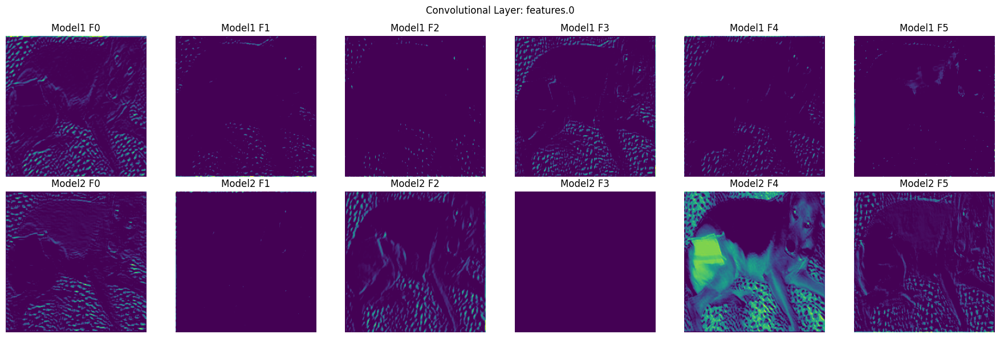

Visualizing Layer: features.1


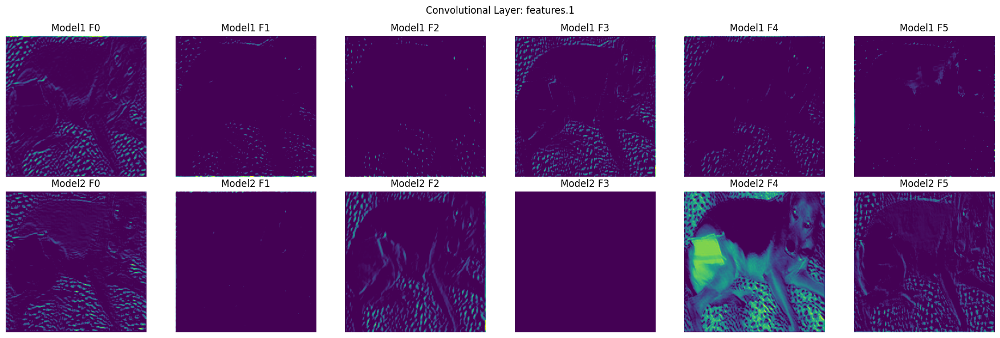

Visualizing Layer: features.2


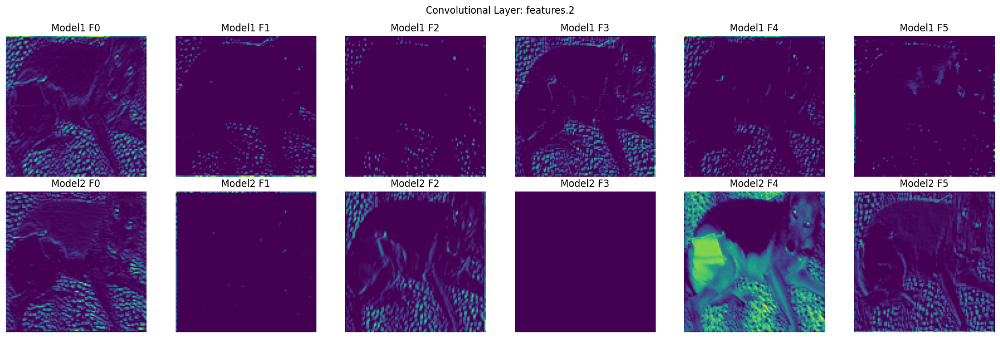

Visualizing Layer: features.3


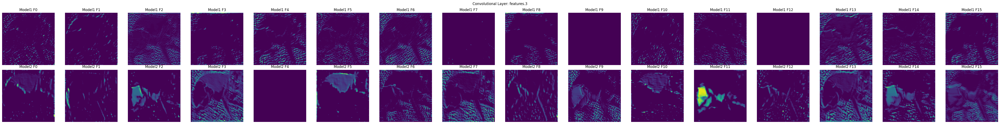

Visualizing Layer: features.4


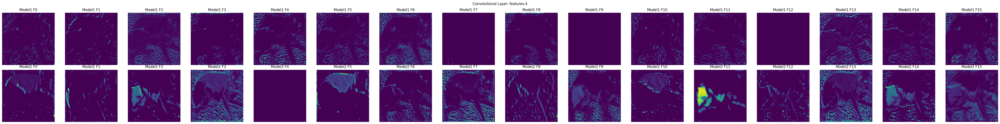

Visualizing Layer: features.5


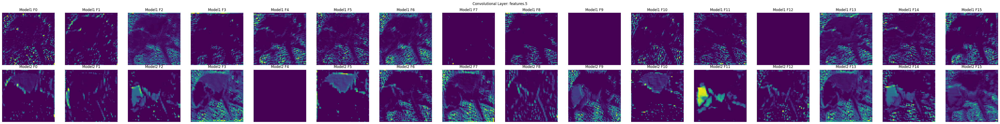

Visualizing Layer: features.6


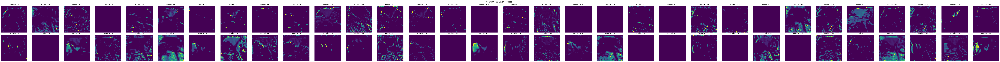

Visualizing Layer: features.7


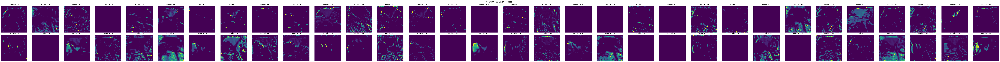

Visualizing Layer: features.8


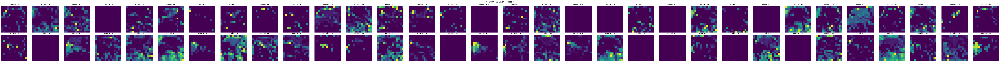

Visualizing Layer: features.9


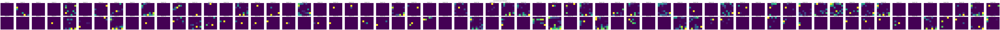

Visualizing Layer: features.10


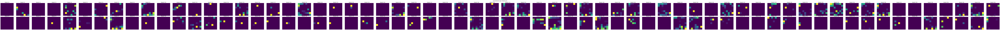

Visualizing Layer: features.11


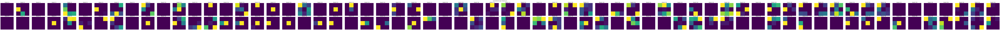

Visualizing Layer: features


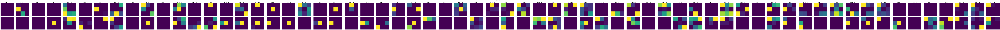

Visualizing Layer: classifier.0


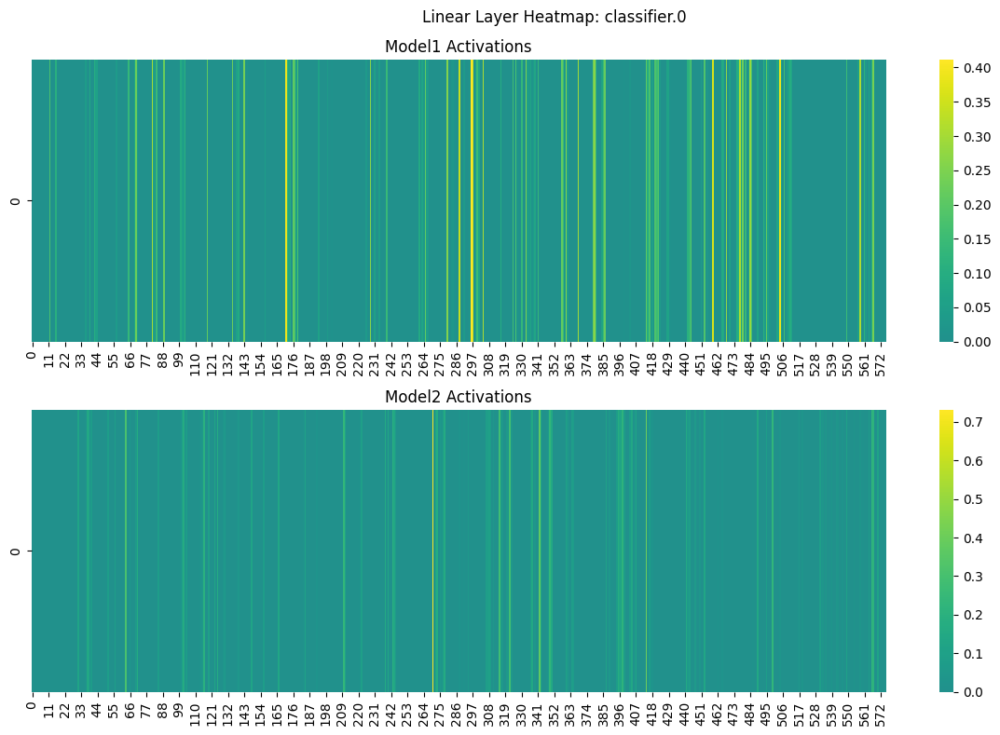

Visualizing Layer: classifier.1


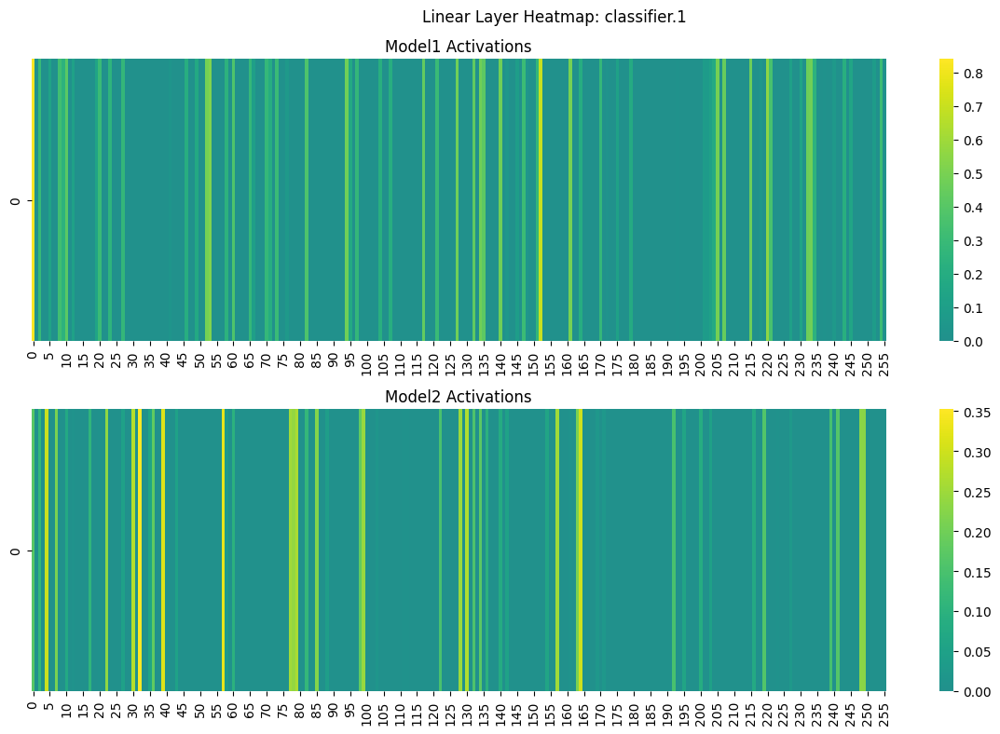

Visualizing Layer: classifier.2


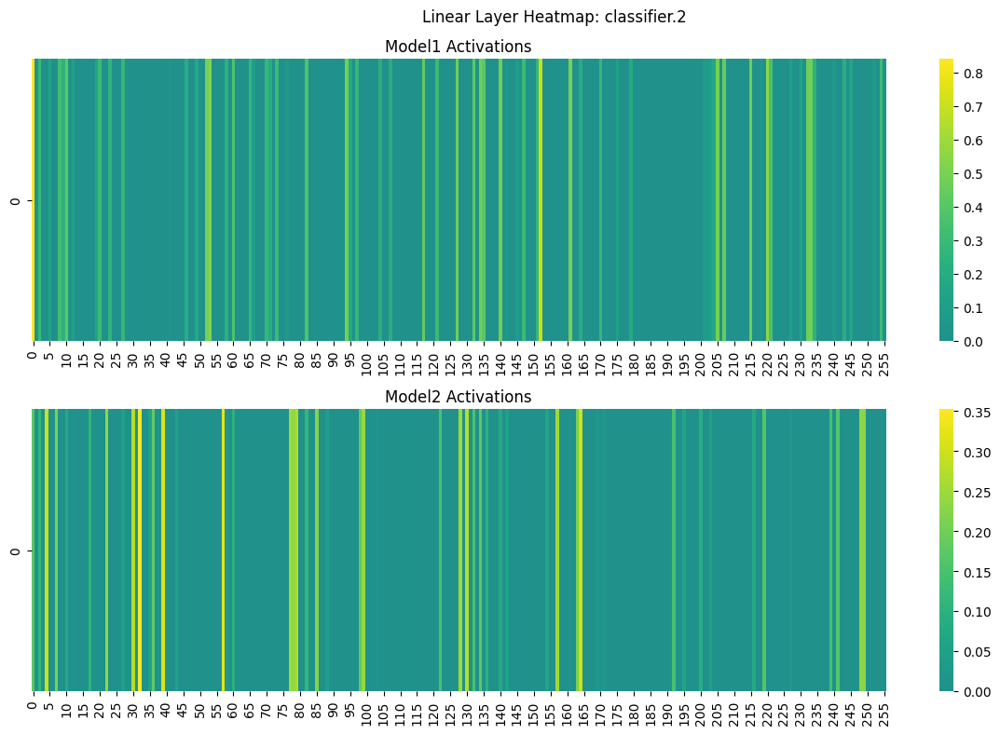

Visualizing Layer: classifier.3


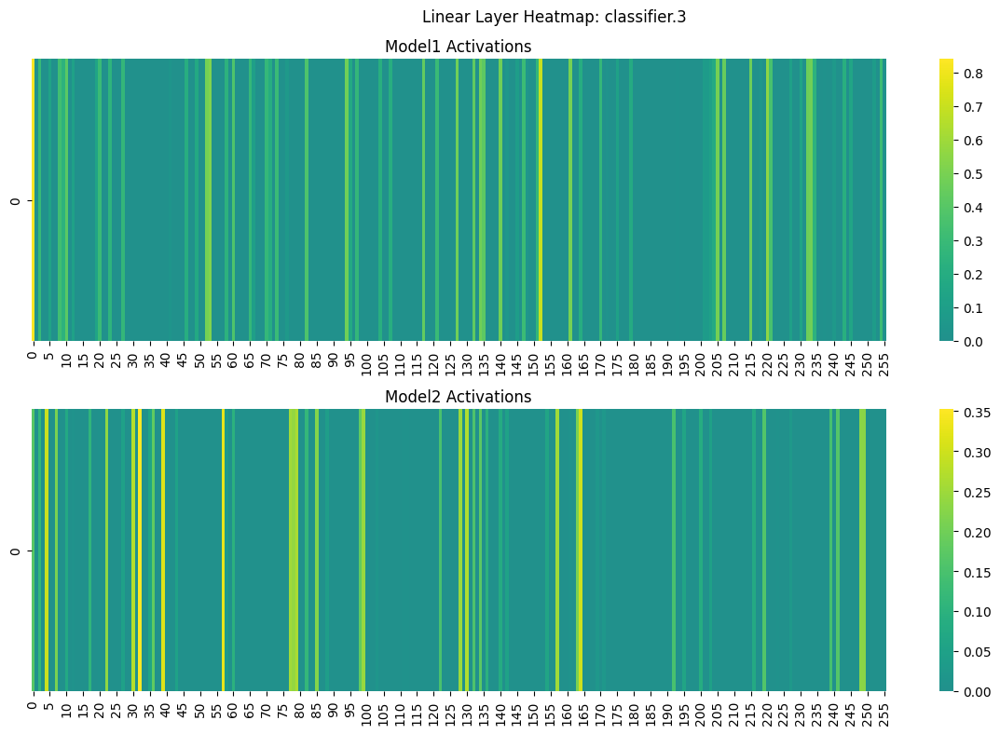

Visualizing Layer: classifier.4


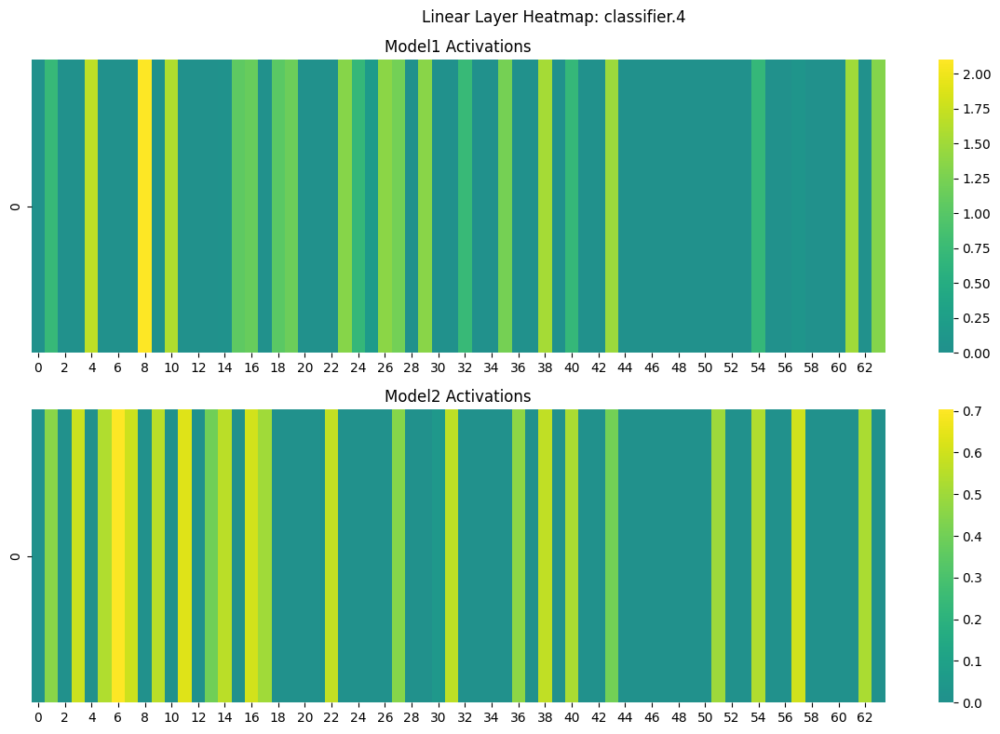

Visualizing Layer: classifier.5


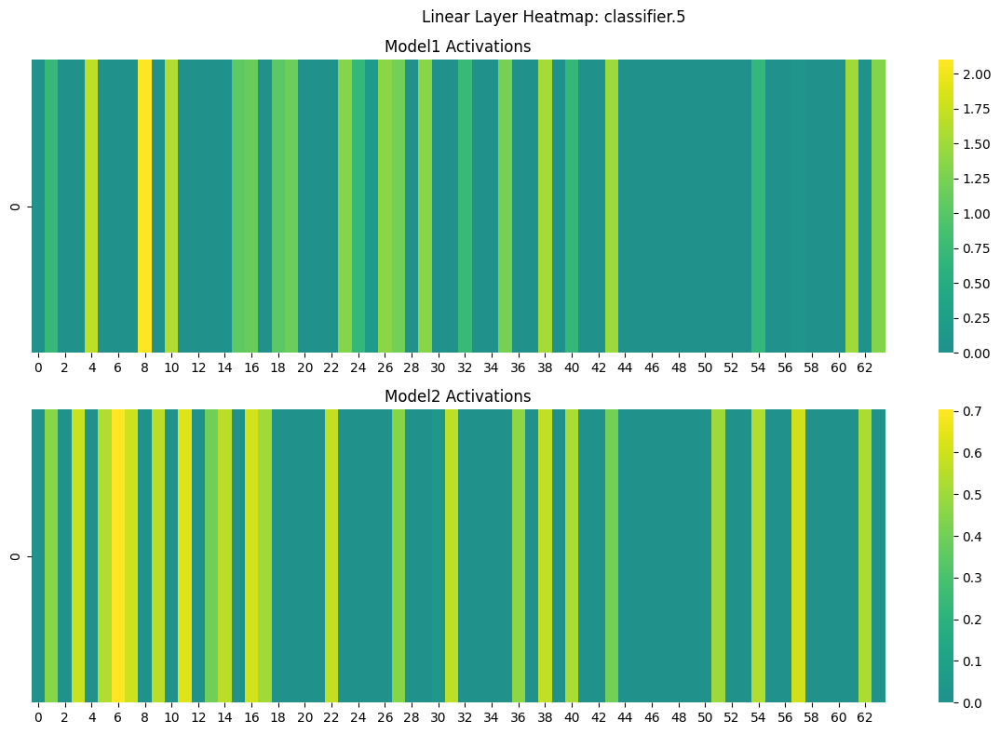

Visualizing Layer: classifier.6


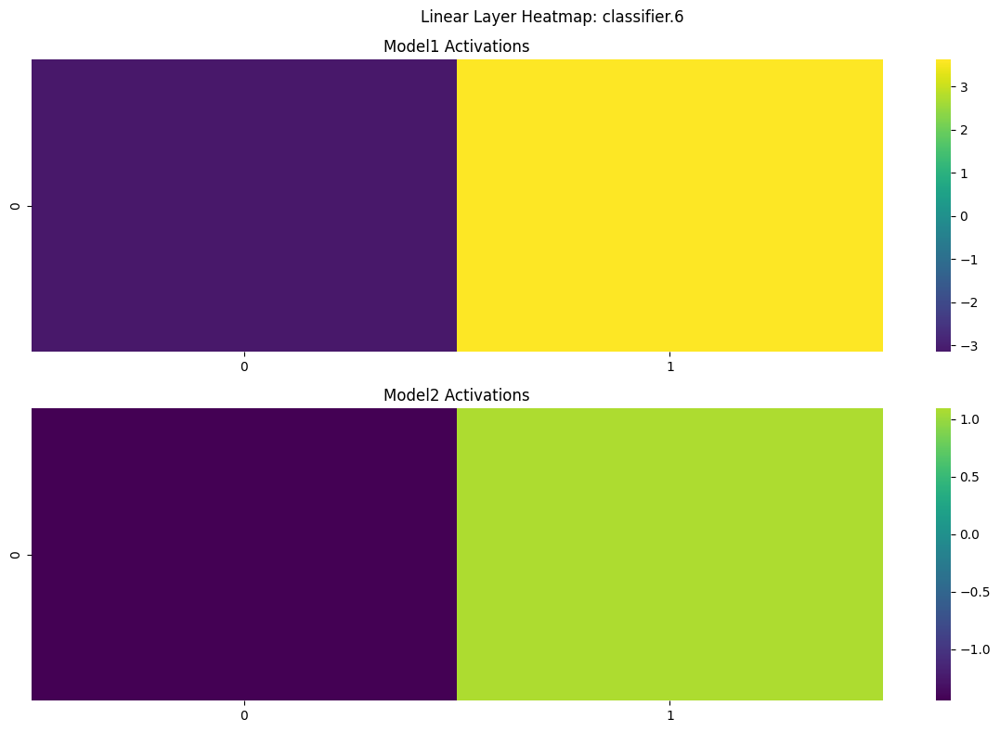

Visualizing Layer: classifier


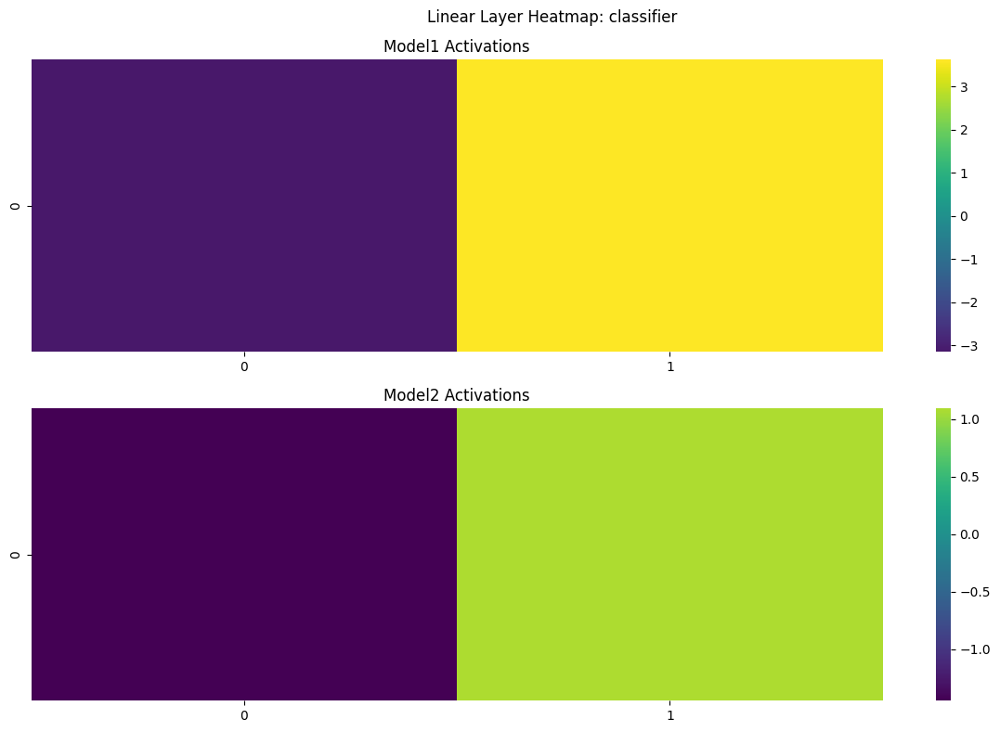

Visualizing Layer: 


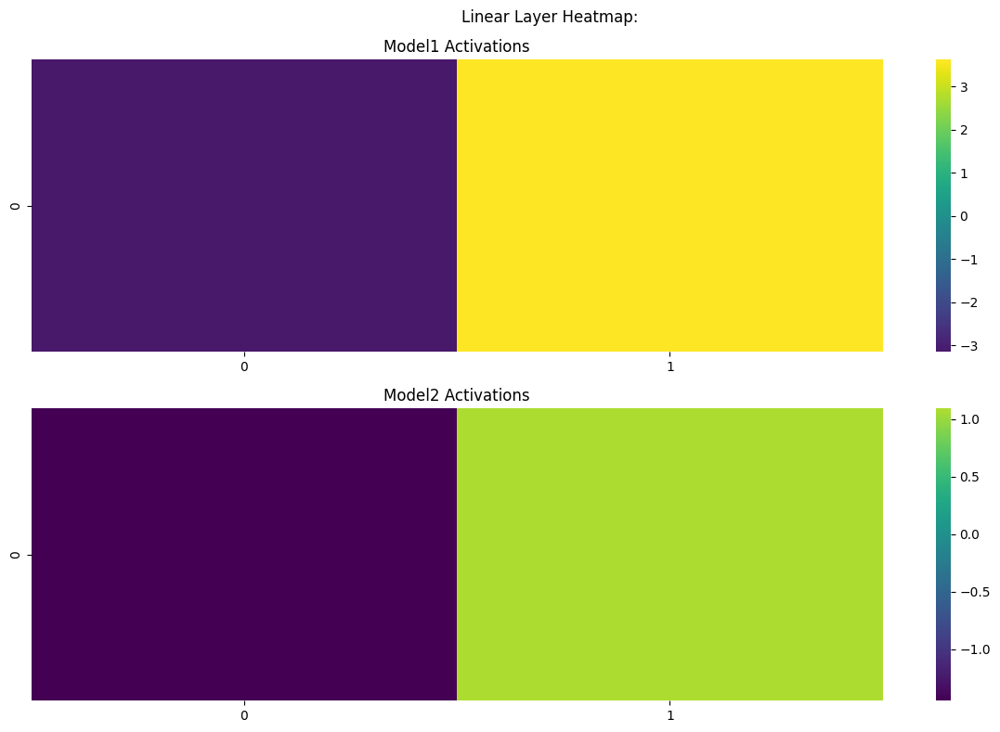

In [19]:
visualize_feature_maps_v(
    feature_maps_1,
    feature_maps_2,
    "Model1",
    "Model2",
    linear_viz_type='heatmap'  # 'distribution', 'heatmap', 'scatter', or 'boxplot'
)

Model: Model 1, Layer: features.0


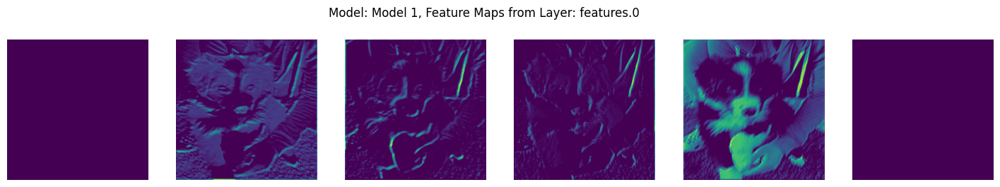

Model: Model 1, Layer: features.1


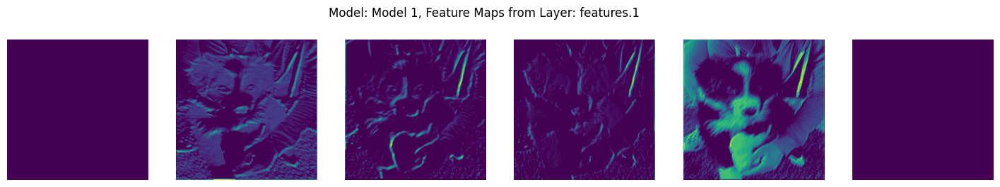

Model: Model 1, Layer: features.2


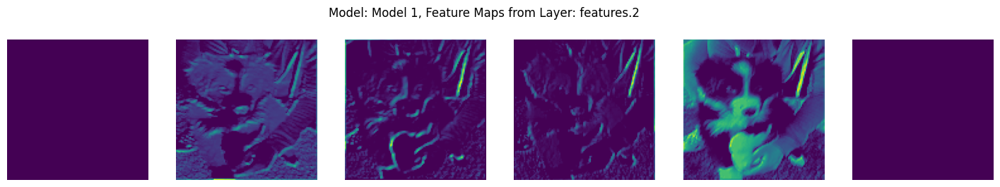

Model: Model 1, Layer: features.3


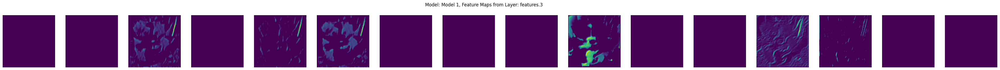

Model: Model 1, Layer: features.4


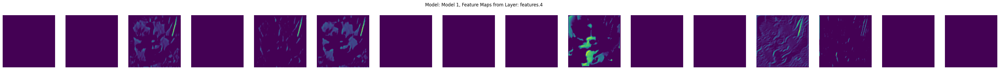

Model: Model 1, Layer: features.5


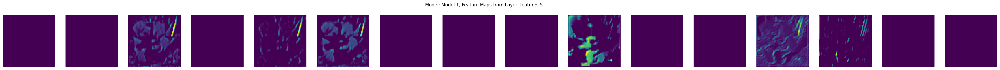

Model: Model 1, Layer: features.6


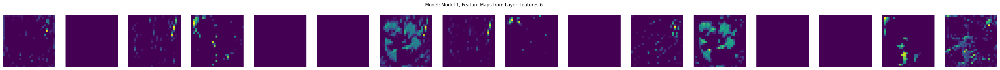

Model: Model 1, Layer: features.7


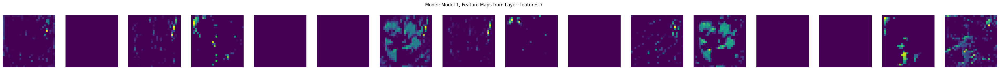

Model: Model 1, Layer: features.8


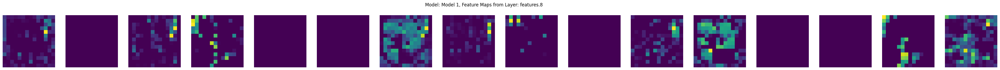

Model: Model 1, Layer: features.9


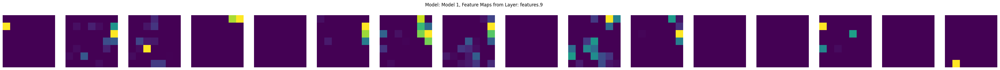

Model: Model 1, Layer: features.10


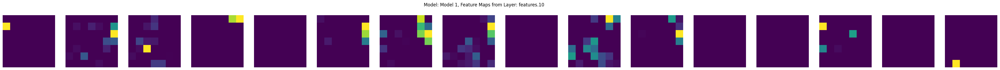

Model: Model 1, Layer: features.11


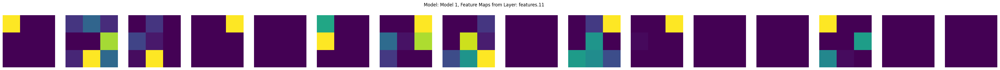

Model: Model 1, Layer: features


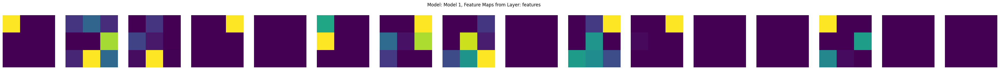

Model: Model 1, Layer: classifier.0


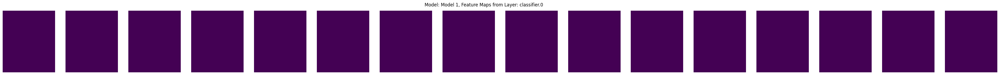

Model: Model 1, Layer: classifier.1


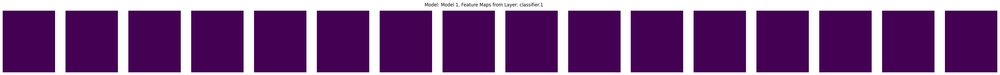

Model: Model 1, Layer: classifier.2


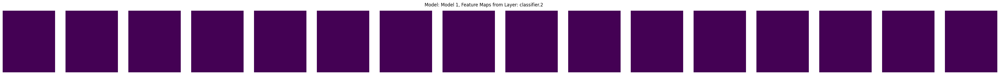

Model: Model 1, Layer: classifier.3


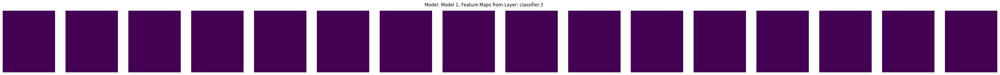

Model: Model 1, Layer: classifier.4


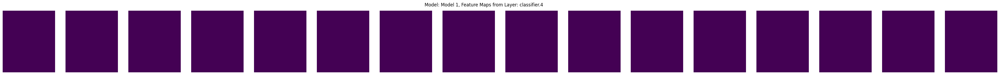

Model: Model 1, Layer: classifier.5


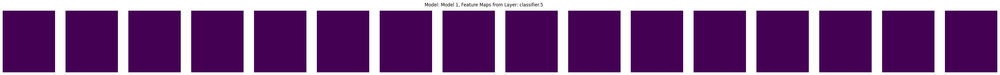

Model: Model 1, Layer: classifier.6


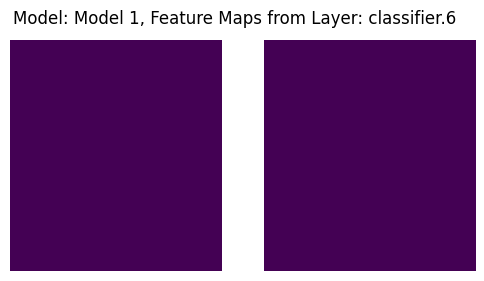

Model: Model 1, Layer: classifier


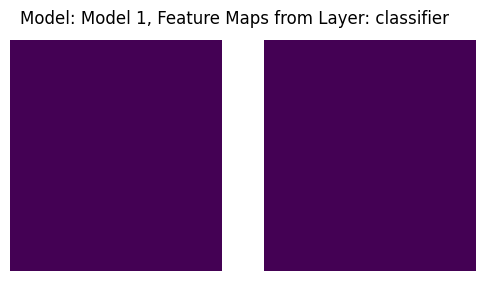

Model: Model 1, Layer: 


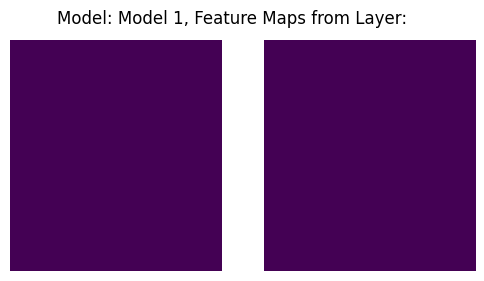

Model: Model 2, Layer: features.0


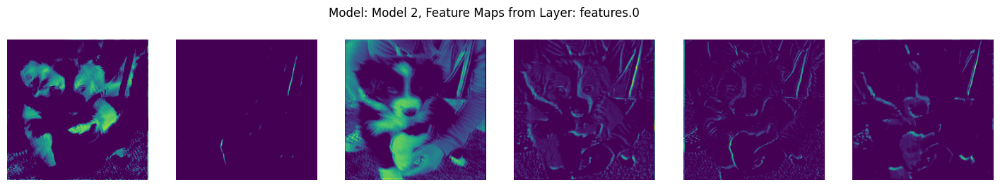

Model: Model 2, Layer: features.1


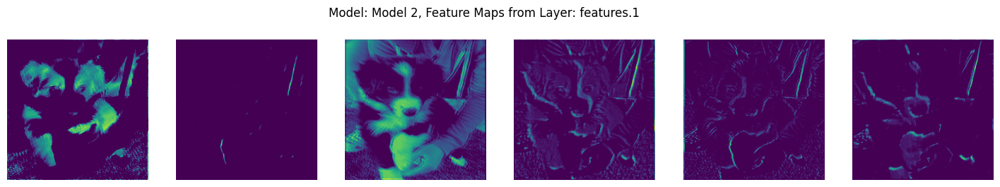

Model: Model 2, Layer: features.2


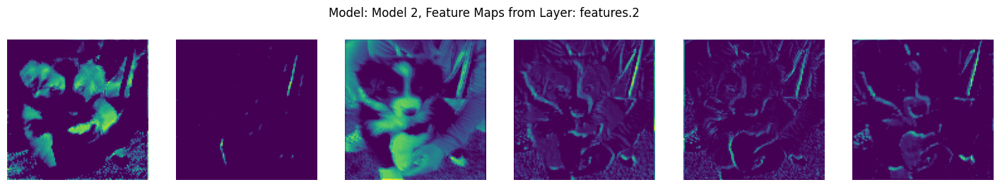

Model: Model 2, Layer: features.3


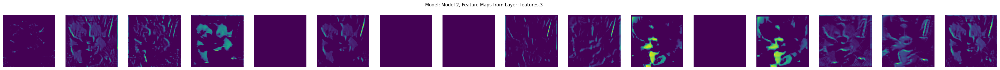

Model: Model 2, Layer: features.4


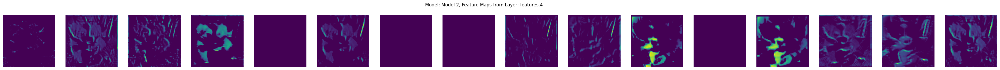

Model: Model 2, Layer: features.5


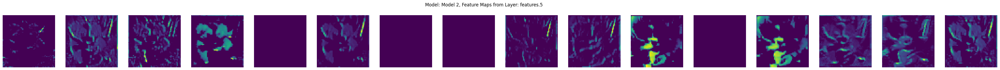

Model: Model 2, Layer: features.6


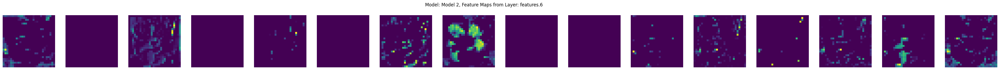

Model: Model 2, Layer: features.7


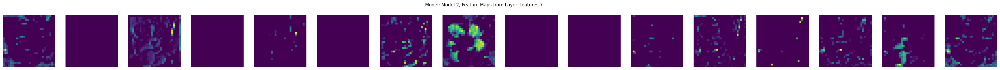

Model: Model 2, Layer: features.8


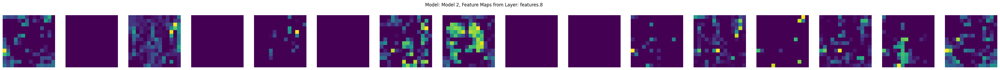

Model: Model 2, Layer: features.9


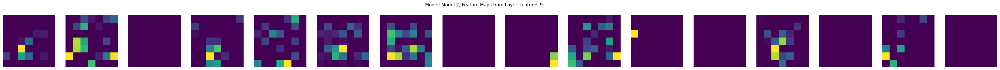

Model: Model 2, Layer: features.10


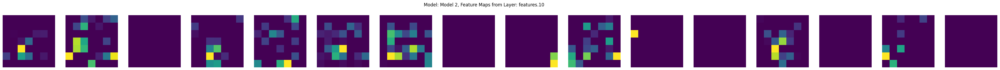

Model: Model 2, Layer: features.11


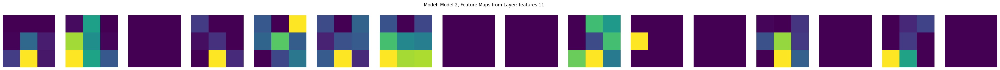

Model: Model 2, Layer: features


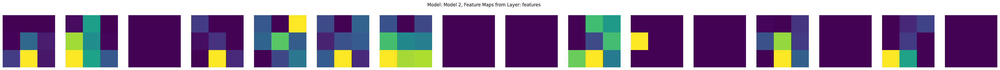

Model: Model 2, Layer: classifier.0


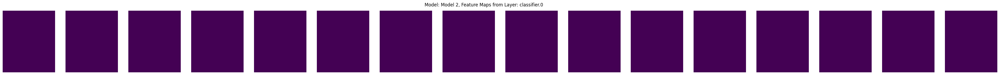

Model: Model 2, Layer: classifier.1


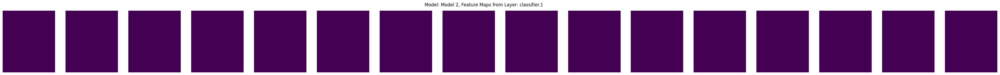

Model: Model 2, Layer: classifier.2


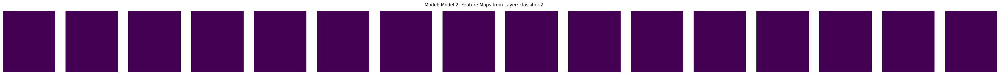

Model: Model 2, Layer: classifier.3


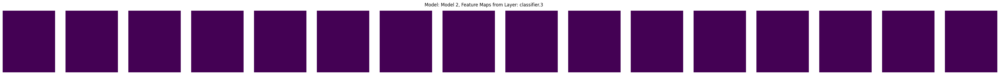

Model: Model 2, Layer: classifier.4


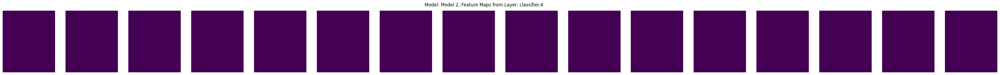

Model: Model 2, Layer: classifier.5


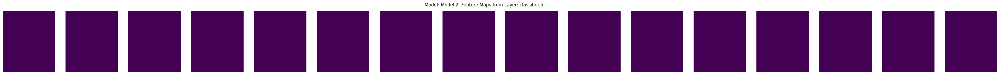

Model: Model 2, Layer: classifier.6


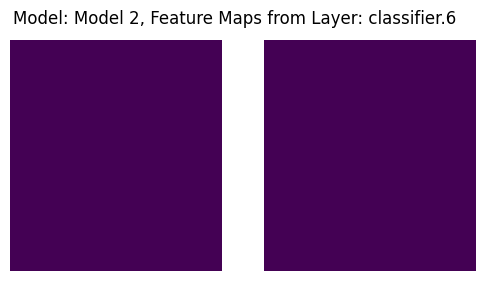

Model: Model 2, Layer: classifier


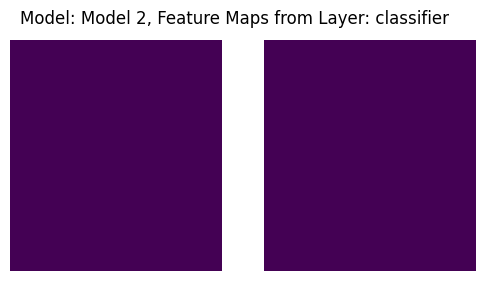

Model: Model 2, Layer: 


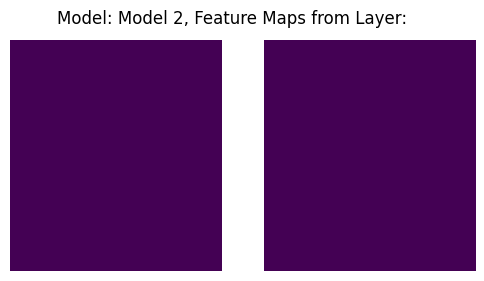

In [52]:
visualize_feature_maps_h(feature_maps_1, "Model 1")
visualize_feature_maps_h(feature_maps_2, "Model 2")